<a href="https://colab.research.google.com/github/AtharvanDogra/ionathon/blob/master/Stock_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# for frontend live tweet scores


In [4]:
from tensorflow import keras

In [5]:
model = keras.models.load_model('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/apple_savedmodel')

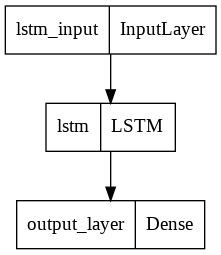

In [7]:
from keras.utils.vis_utils import plot_model
plot_model(model, to_file='model.png')

In [13]:
pd.DataFrame([[1,2],[3,4]], columns = ['a', 'b'])#[:1]

,a,b
0,1,2
1,3,4


In [51]:
 import requests
 from datetime import datetime
 res = requests.get('https://api.polygon.io/v2/aggs/ticker/AAPL/range/1/day/2022-03-22/2022-03-26?adjusted=true&sort=desc&apiKey=39ngr6sQIbZKPDfWGh4yMh5dLzpL9wzf').json()

        # datetime.utcfromtimestamp(ts).strftime('%Y-%m-%d %H:%M:%S'))
stock_60 = pd.DataFrame(list(zip([datetime.fromtimestamp(agg['t']/1000).strftime('%Y-%m-%d') for agg in res['results']][:60], [agg['c'] for agg in res['results']][:60], [agg['o'] for agg in res['results']][:60])), columns = ['Date', 'Close', 'Open'])

In [52]:
stock_60

,Date,Close,Open
0,2022-03-25,174.72,173.88
1,2022-03-24,174.07,171.06
2,2022-03-23,170.21,167.99
3,2022-03-22,168.82,165.51


In [8]:
# !pip install vaderSentiment                 #requirement

import pandas as pd
import re
# from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from datetime import date
import numpy as np


def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

def clean(text):
    text = str(text)
    text = text.lower()
    text = re.sub(r'http\S+', ' ', text)
    text = re.sub(r'pic.twitter\S+', ' ', text)
    # text = decontracted(text)
    text = re.sub(r'\(([^)]+)\)', " ", text)
    text = text.replace('etmarkets', ' ').replace('marketupdates', ' ').replace('newsalert', ' ').replace('ndtv', ' ').replace('moneycontrol', ' ').replace('here is why', ' ')
    text = text.replace('marketsupdate', ' ').replace('biznews', ' ').replace('click here', ' ').replace('live updates', ' ').replace('et now', ' ')
    text = re.sub(r'[^a-zA-Z0-9 ]+', ' ', text)
    text = re.sub(r' \w{1,2}_', ' ', text)
    text = re.sub('\s+',' ', text)
    return text


# analyzer = SentimentIntensityAnalyzer()
# def sentiments(text):
#     return analyzer.polarity_scores(text)['compound']

In [5]:
!pip install flair

     |████████████████████████████████| 322 kB 5.0 MB/s 
     |████████████████████████████████| 3.8 MB 51.3 MB/s 
     |████████████████████████████████| 48 kB 4.9 MB/s 
     |████████████████████████████████| 53 kB 1.3 MB/s 
     |████████████████████████████████| 788 kB 42.8 MB/s 
     |████████████████████████████████| 1.2 MB 53.5 MB/s 
     |████████████████████████████████| 19.7 MB 1.3 MB/s 
     |████████████████████████████████| 67 kB 5.4 MB/s 
     |████████████████████████████████| 981 kB 63.9 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 46 kB 3.7 MB/s 
     |████████████████████████████████| 63 kB 1.7 MB/s 
     |████████████████████████████████| 6.5 MB 50.0 MB/s 
     |████████████████████████████████| 596 kB 56.3 MB/s 
     |████████████████████████████████| 895 kB 54.1 MB/s 
  Created wheel for gdown: filename=gdown-3.12.2-py3-none-any.whl size=96

In [6]:
from scipy.stats import pearsonr
from flair.models import TextClassifier
from flair.data import Sentence
classifier = TextClassifier.load('en-sentiment')
def flair_sentiments(text):
    sentence = Sentence(text)
    classifier.predict(sentence)
    try:
        return sentence.labels[0].score if sentence.labels[0].value == 'POSITIVE' else -sentence.labels[0].score
    except: 
        return None

def weekly_correlation(df):
    a = np.array(df['close_price'])
    b = np.array(df['score'])
    b_adjusted = np.append(b[1:],1)
    b_adjusted, b

    return pearsonr(a,b_adjusted)

2022-03-26 18:19:39,844 https://nlp.informatik.hu-berlin.de/resources/models/sentiment-curated-distilbert/sentiment-en-mix-distillbert_4.pt not found in cache, downloading to /tmp/tmpblzz4h6c


100%|██████████| 265512723/265512723 [00:14<00:00, 18272165.58B/s]

2022-03-26 18:19:54,773 copying /tmp/tmpblzz4h6c to cache at /root/.flair/models/sentiment-en-mix-distillbert_4.pt


2022-03-26 18:19:55,720 removing temp file /tmp/tmpblzz4h6c
2022-03-26 18:19:55,787 loading file /root/.flair/models/sentiment-en-mix-distillbert_4.pt


Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/226k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/455k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/483 [00:00<?, ?B/s]

In [7]:
-flair_sentiments("My portfolio finally back to even. Geez that was scary 😨.")[0].score  #score

TypeError: ignored

##apis

In [ ]:
import requests
stockArr = requests.get(f'https://api.polygon.io/v2/aggs/ticker/.DJI/range/1/day/2021-12-15/2022-03-26?adjusted=true&sort=desc&apiKey=39ngr6sQIbZKPDfWGh4yMh5dLzpL9wzf').json()
stock_60 = [agg['c'] for agg in stockArr['results']]
stock_60[:60]

KeyError: ignored

In [1]:
!pip install nsepy
import nsepy

  Created wheel for nsepy: filename=nsepy-0.8-py3-none-any.whl size=36084 sha256=de202686f38608e47b459660df04bc07727367eb6df0a01baefd387be58d0bf0
  Stored in directory: /root/.cache/pip/wheels/32/ab/d9/78ceea14cdf6de83376082b3cb0c2999fd77f823e35c47b9ec
Successfully built nsepy


In [ ]:
from nsepy import get_history
from datetime import date
data = get_history(symbol="NIFTY", start=date(2022,3,22), end=date(2022,3,26))
data

#Loading Libraries

In [ ]:
!pip install twint

In [ ]:
!pip install vaderSentiment

In [ ]:
import pandas as pd
from urllib.request import Request, urlopen
from bs4 import BeautifulSoup as soup
import twint
import random
import re
from tqdm import tqdm
# from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import date
import numpy as np

#Data Collection

##2. Scraping tweets about market condition

In [ ]:
%cd '/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments'

/content/drive/.shortcut-targets-by-id/1zU2BNUuNh_JELlM5DOwfVvOlttd0NaFO/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments


In [ ]:
!pip uninstall twint
!pip uninstall aiohttp

In [53]:
!git clone --depth=1 https://github.com/twintproject/twint.git
!cd twint && pip3 install . -r requirements.txt

Cloning into 'twint'...
remote: Enumerating objects: 47, done.
remote: Counting objects: 100% (47/47), done.
remote: Compressing objects: 100% (44/44), done.
remote: Total 47 (delta 3), reused 14 (delta 0), pack-reused 0
Unpacking objects: 100% (47/47), done.
Processing /content/twint
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 1.1 MB 5.1 MB/s 
     |████████████████████████████████| 263 kB 46.6 MB/s 
     |████████████████████████████████| 372 kB 52.2 MB/s 
     |████████████████████████████████| 94 kB 3.0 MB/s 
     |████████████████████████████████| 144 kB 37.1 MB/s 
     |█████████████████████████

In [54]:
pip install aiohttp==3.7.0

     |████████████████████████████████| 1.3 MB 4.5 MB/s 
  Attempting uninstall: async-timeout
    Found existing installation: async-timeout 4.0.2
    Uninstalling async-timeout-4.0.2:
      Successfully uninstalled async-timeout-4.0.2
  Attempting uninstall: aiohttp
    Found existing installation: aiohttp 3.8.1
    Uninstalling aiohttp-3.8.1:
      Successfully uninstalled aiohttp-3.8.1


In [55]:
import datetime
today = datetime.datetime.today().date()
yesterday = today - datetime.timedelta(days=1)
str(today), str(yesterday)

('2022-03-26', '2022-03-25')

In [58]:
import twint
import nest_asyncio
nest_asyncio.apply()
import time
import pandas as pd
import os
import re
timestr = time.strftime("%Y%m%d")

config = twint.Config()
# config.Near = 'Mumbai'
config.Search = 'aapl'
config.Lang = "en"
config.Since = '2022-03-24'
config.Until = '2022-03-26'
config.Popular_tweets = True
config.Pandas = True
config.limit = 2

twint.run.Search(config)

In [56]:
tweets_df = twint.storage.panda.Tweets_df

In [57]:
tweets_df1 = twint.storage.panda.Tweets_df.copy()

AttributeError: ignored

In [ ]:
def stripdate(date):
    return date.split(' ')[0]

In [ ]:
tweets_df1['date'] = tweets_df1['date'].apply(stripdate)
tweets_df1['tweet_clean'] = tweets_df1['tweet'].apply(clean)
tweets_df1

In [ ]:
tweets_df1[['date', 'tweet']]

In [ ]:
dftweet = tweets_df1.sort_values(['date','nreplies','nlikes','nretweets'], ascending=[False, False, False, False])[['date', 'tweet', 'tweet_clean', 'nlikes','nretweets', 'nreplies']].reset_index()

In [ ]:
a = list(dftweet.columns)
a.append('sentiment')
df_final = pd.DataFrame()
for date in list(dftweet['date'].unique()):
    df_temp = pd.DataFrame()
    df_temp = df_temp.append(dftweet[dftweet['date']==date][:20])

    df_temp['sentiment'] = dftweet[dftweet['date']==date][:20]['tweet'].apply(flair_sentiments)
    df_final = df_final.append(df_temp)


In [ ]:
df_final.sort_values(['date', 'sentiment'], ascending= [False, False])

In [ ]:
flair_sentiments(dftweet['tweet'][0])

0.7724295258522034

In [ ]:
from nsepy import get_history
data = get_history(symbol='NIFTY', start=datetime.datetime.today().date() - datetime.timedelta(days=7), end=datetime.datetime.today().date(), index=True)
data

#Data Cleaning and Pre-processing

In [ ]:
#Cleaning the tweets

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

def clean(text):
    text = str(text)
    text = text.lower()
    text = re.sub(r'http\S+', ' ', text)
    text = re.sub(r'pic.twitter\S+', ' ', text)
    text = decontracted(text)
    text = re.sub(r'\(([^)]+)\)', " ", text)
    text = text.replace('etmarkets', ' ').replace('marketupdates', ' ').replace('newsalert', ' ').replace('ndtv', ' ').replace('moneycontrol', ' ').replace('here is why', ' ')
    text = text.replace('marketsupdate', ' ').replace('biznews', ' ').replace('click here', ' ').replace('live updates', ' ').replace('et now', ' ')
    text = re.sub(r'[^a-zA-Z ]+', ' ', text)
    text = re.sub(r' \w{1,2}_', ' ', text)
    text = re.sub('\s+',' ', text)
    return text

#Stock Data

### Apple

In [ ]:
apple = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/AppleFinalData.csv')

In [ ]:
aapl_prices = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/AAPL.csv')

In [ ]:
aapl_prices = aapl_prices[['Date', 'Open', 'Close']]
aapl_prices

,Date,Open,Close
0,2006-12-01,3.278571,3.261429
1,2006-12-04,3.281429,3.254286
2,2006-12-05,3.273214,3.259643
3,2006-12-06,3.237143,3.208214
4,2006-12-07,3.215357,3.108571
...,...,...,...
2512,2016-11-23,27.840000,27.807501
2513,2016-11-25,27.782499,27.947500
2514,2016-11-28,27.857500,27.892500
2515,2016-11-29,27.695000,27.865000


price adjusted as there was some inaccuracy in price  (approx factor 4.5)

In [ ]:
apple = apple[['Date', 'Adj Close', 'compound']]
apple['close_price'] = (apple['Adj Close']/4.5).round(2)
apple = apple.drop('Adj Close', axis=1)

apple['date'] = apple['Date']
apple = apple.drop('Date', axis=1)

apple['score'] = apple['compound']
apple = apple.drop('compound', axis=1)

apple

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,close_price,date,score
0,2.90,2006-12-01,0.7707
1,2.89,2006-12-04,0.8720
2,2.90,2006-12-05,0.0000
3,2.85,2006-12-06,0.6858
4,2.76,2006-12-07,-0.6712
...,...,...,...
2512,24.72,2016-11-23,0.0000
2513,24.84,2016-11-25,-0.8990
2514,24.79,2016-11-28,0.0000
2515,24.77,2016-11-29,0.0000


In [ ]:
apple['open_price'] = aapl_prices['Open']
apple['close_price'] = aapl_prices['Close']
apple

,close_price,date,score,open_price
0,3.261429,2006-12-01,0.7707,3.278571
1,3.254286,2006-12-04,0.8720,3.281429
2,3.259643,2006-12-05,0.0000,3.273214
3,3.208214,2006-12-06,0.6858,3.237143
4,3.108571,2006-12-07,-0.6712,3.215357
...,...,...,...,...
2512,27.807501,2016-11-23,0.0000,27.840000
2513,27.947500,2016-11-25,-0.8990,27.782499
2514,27.892500,2016-11-28,0.0000,27.857500
2515,27.865000,2016-11-29,0.0000,27.695000


In [ ]:
s = set(list(apple['date']))
n = set(list(aapl_prices['Date']))

common_dates_1 = [x for x in s if x in n]
len(common_dates_1)

2517

In [ ]:
from scipy.stats import pearsonr

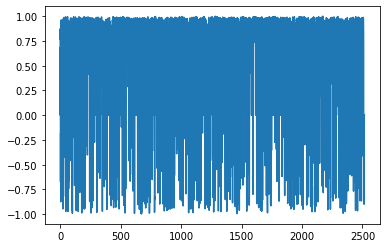

In [ ]:
apple['score'].plot()

In [ ]:
a = np.array(apple['close_price'])
b = np.array(apple['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([0.872 , 0.    , 0.6858, ..., 0.    , 0.    , 1.    ]),
 array([0.7707, 0.872 , 0.    , ..., 0.    , 0.    , 0.    ]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b)

((0.008965843645490393, 0.6529993277659658),
 (0.009835749567124491, 0.6218546505540825))

In [ ]:
pearsonr(np.diff(a,n=1,axis=0), b_adjusted[:-1]), pearsonr(np.diff(a,n=1,axis=0), b[1:])

((0.04932037709552979, 0.013354467837057913),
 (0.04932037709552979, 0.013354467837057913))

#### open-close

In [ ]:
apple['open-close'] = apple['open_price'] - apple['close_price']
apple

,close_price,date,score,open_price,open-close
0,3.261429,2006-12-01,0.7707,3.278571,0.017142
1,3.254286,2006-12-04,0.8720,3.281429,0.027143
2,3.259643,2006-12-05,0.0000,3.273214,0.013571
3,3.208214,2006-12-06,0.6858,3.237143,0.028929
4,3.108571,2006-12-07,-0.6712,3.215357,0.106786
...,...,...,...,...,...
2512,27.807501,2016-11-23,0.0000,27.840000,0.032499
2513,27.947500,2016-11-25,-0.8990,27.782499,-0.165001
2514,27.892500,2016-11-28,0.0000,27.857500,-0.035000
2515,27.865000,2016-11-29,0.0000,27.695000,-0.170000


In [ ]:
a = np.array(apple['open-close'])
a_adjusted = np.append(a[1:],1)
b = np.array(apple['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([0.872 , 0.    , 0.6858, ..., 0.    , 0.    , 1.    ]),
 array([0.7707, 0.872 , 0.    , ..., 0.    , 0.    , 0.    ]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b), pearsonr(a_adjusted, b)

((-0.01677554610400071, 0.4001992445177123),
 (-0.013193996334258629, 0.5082026172625335),
 (0.0034467938982931066, 0.8627777665693057))

### Microsoft

In [ ]:
microsoft = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/MicrosoftFinalData.csv')

In [ ]:
msft_prices = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/MSFT.csv')

In [ ]:
msft_prices = msft_prices[['Date', 'Open', 'Close']]
msft_prices

,Date,Open,Close
0,2006-12-01,29.230000,29.120001
1,2006-12-04,29.230000,29.330000
2,2006-12-05,29.360001,29.129999
3,2006-12-06,29.100000,28.990000
4,2006-12-07,28.959999,28.850000
...,...,...,...
2512,2016-11-23,61.009998,60.400002
2513,2016-11-25,60.299999,60.529999
2514,2016-11-28,60.340000,60.610001
2515,2016-11-29,60.650002,61.090000


In [ ]:
microsoft = microsoft[['Date', 'Adj Close', 'compound']]
microsoft['close_price'] = microsoft['Adj Close']
microsoft = microsoft.drop('Adj Close', axis=1)

microsoft['date'] = microsoft['Date']
microsoft = microsoft.drop('Date', axis=1)

microsoft['score'] = microsoft['compound']
microsoft = microsoft.drop('compound', axis=1)
microsoft['open_price'] = msft_prices['Open']

microsoft

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,close_price,date,score,open_price
0,29.12,2006-12-01,0.0000,29.230000
1,29.33,2006-12-04,-0.7783,29.230000
2,29.13,2006-12-05,0.0000,29.360001
3,28.99,2006-12-06,0.9003,29.100000
4,28.85,2006-12-07,0.6597,28.959999
...,...,...,...,...
2512,60.40,2016-11-23,0.8478,61.009998
2513,60.53,2016-11-25,0.0000,60.299999
2514,60.61,2016-11-28,0.0000,60.340000
2515,61.09,2016-11-29,0.0000,60.650002


In [ ]:
s = set(list(apple['date']))
n = set(list(aapl_prices['Date']))

common_dates_1 = [x for x in s if x in n]
len(common_dates_1)

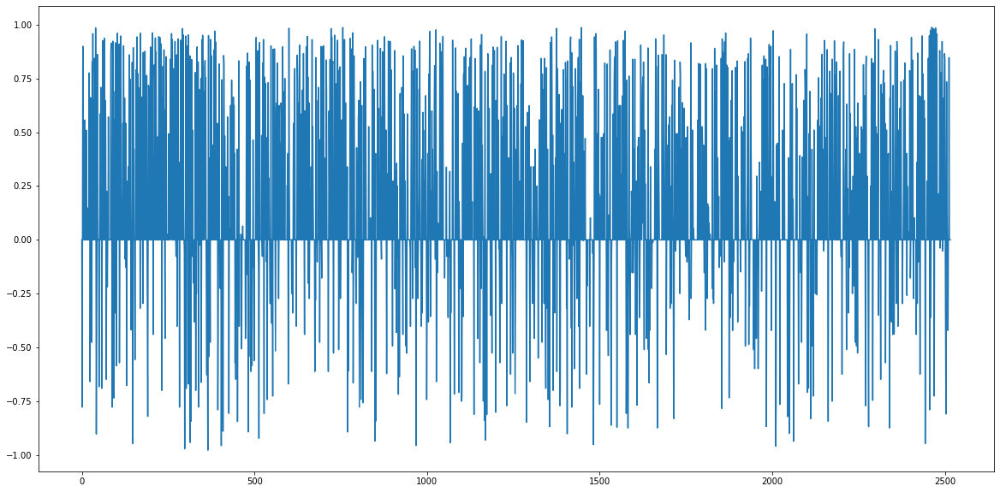

In [ ]:
microsoft['score'].plot(figsize=(20,10))

In [ ]:
a = np.array(microsoft['close_price'])
b = np.array(microsoft['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.7783,  0.    ,  0.9003, ...,  0.    ,  0.    ,  1.    ]),
 array([ 0.    , -0.7783,  0.    , ...,  0.    ,  0.    ,  0.    ]))

In [ ]:
len(np.diff(a,n=1,axis=0))

2516

In [ ]:
pearsonr(np.diff(a,n=1,axis=0), b_adjusted[:-1]), pearsonr(np.diff(a,n=1,axis=0), b[1:])

((0.010818555755576402, 0.5875414618870153),
 (0.010818555755576402, 0.5875414618870153))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b)

((0.018002632922964612, 0.366625988490804),
 (0.016518411818869733, 0.40746165957037))

#### open-close difference

In [ ]:
microsoft['open-close'] = microsoft['open_price'] - microsoft['close_price']
microsoft

,close_price,date,score,open_price,open-close
0,29.12,2006-12-01,0.0000,29.230000,0.110000
1,29.33,2006-12-04,-0.7783,29.230000,-0.100000
2,29.13,2006-12-05,0.0000,29.360001,0.230001
3,28.99,2006-12-06,0.9003,29.100000,0.110000
4,28.85,2006-12-07,0.6597,28.959999,0.109999
...,...,...,...,...,...
2512,60.40,2016-11-23,0.8478,61.009998,0.609998
2513,60.53,2016-11-25,0.0000,60.299999,-0.230001
2514,60.61,2016-11-28,0.0000,60.340000,-0.270000
2515,61.09,2016-11-29,0.0000,60.650002,-0.439998


In [ ]:
a = np.array(microsoft['open-close'])
a_adjusted = np.append(a[1:],1)
b = np.array(microsoft['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.7783,  0.    ,  0.9003, ...,  0.    ,  0.    ,  1.    ]),
 array([ 0.    , -0.7783,  0.    , ...,  0.    ,  0.    ,  0.    ]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b), pearsonr(a_adjusted, b)

((-0.0375882196249869, 0.059359706092691325),
 (0.007579518474535216, 0.7038869015821942),
 (0.009535390107291673, 0.6325356094795074))

### Nifty

dataset from 2003-2020

In [ ]:
nifty_senti = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/filename.csv')

In [ ]:
nifty_price = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/nifty_50 - Sheet1.csv')

In [ ]:
nifty_price

,Date,Open,High,Low,Close,Volume
0,11/02/2003 15:30:00,1048.61,1055.80,1044.55,1048.02,0
1,12/02/2003 15:30:00,1048.16,1051.01,1040.41,1044.47,0
2,14/02/2003 15:30:00,1044.44,1047.05,1034.10,1035.99,0
3,17/02/2003 15:30:00,1036.21,1060.51,1036.21,1058.22,0
4,18/02/2003 15:30:00,1058.95,1065.13,1057.61,1059.29,0
...,...,...,...,...,...,...
4241,19/05/2020 15:30:00,8961.70,9030.35,8855.30,8879.10,0
4242,20/05/2020 15:30:00,8889.15,9093.80,8875.35,9066.55,0
4243,21/05/2020 15:30:00,9079.45,9178.55,9056.10,9106.25,0
4244,22/05/2020 15:30:00,9067.90,9149.60,8968.55,9039.25,0


In [ ]:
import datetime
def change_dt(date):
    return datetime.datetime.strptime(date, '%B %d, %Y, %A').strftime('%Y-%m-%d')

In [ ]:
nifty_senti['date'] = nifty_senti['Date'].apply(change_dt)
nifty_senti.drop('Date', axis=1, inplace=True)
nifty_senti  = nifty_senti[['date', 'compound']]
nifty_senti

,date,compound
0,2020-05-26,0.6369
1,2020-05-26,-0.1531
2,2020-05-25,0.0772
3,2020-05-24,0.0000
4,2020-05-23,0.4404
...,...,...
49995,2003-02-11,-0.1280
49996,2003-02-11,0.0000
49997,2003-02-10,0.0000
49998,2003-02-10,0.0000


In [ ]:
nifty_senti = nifty_senti.groupby(nifty_senti.date).mean().reset_index()
nifty_senti

,date,compound
0,2003-02-10,0.000000
1,2003-02-11,-0.100300
2,2003-02-12,-0.003809
3,2003-02-13,0.091760
4,2003-02-14,0.081383
...,...,...
6063,2020-05-22,-0.132650
6064,2020-05-23,0.220200
6065,2020-05-24,0.000000
6066,2020-05-25,0.077200


In [ ]:
def change_dt_hh(date):
    return datetime.datetime.strptime(date, '%d/%m/%Y %H:%M:%S').strftime('%Y-%m-%d')

In [ ]:
nifty_price['date'] = nifty_price['Date'].apply(change_dt_hh)
nifty_price.drop('Date', axis=1, inplace=True)
nifty_price['close'] = nifty_price['Close']
nifty_price.drop('Close', axis=1, inplace=True)
nifty_price['open_price'] = nifty_price['Open']
nifty_price = nifty_price[['date', 'close', 'open_price']]
nifty_price

,date,close,open_price
0,2003-02-11,1048.02,1048.61
1,2003-02-12,1044.47,1048.16
2,2003-02-14,1035.99,1044.44
3,2003-02-17,1058.22,1036.21
4,2003-02-18,1059.29,1058.95
...,...,...,...
4241,2020-05-19,8879.10,8961.70
4242,2020-05-20,9066.55,8889.15
4243,2020-05-21,9106.25,9079.45
4244,2020-05-22,9039.25,9067.90


In [ ]:
s = set(list(nifty_senti['date']))
n = set(list(nifty_price['date']))

common_dates_1 = [x for x in s if x in n]
len(common_dates_1)

4227

In [ ]:
nifty_senti = nifty_senti.loc[nifty_senti['date'].isin(common_dates_1)].reset_index()
nifty_price = nifty_price.loc[nifty_price['date'].isin(common_dates_1)].reset_index()

In [ ]:
nifty_senti

,index,date,compound
0,1,2003-02-11,-0.100300
1,2,2003-02-12,-0.003809
2,4,2003-02-14,0.081383
3,6,2003-02-17,-0.006143
4,7,2003-02-18,0.000000
...,...,...,...
4222,6060,2020-05-19,-0.009133
4223,6061,2020-05-20,-0.099667
4224,6062,2020-05-21,0.121233
4225,6063,2020-05-22,-0.132650


In [ ]:
nifty_price

,index,date,close,open_price
0,0,2003-02-11,1048.02,1048.61
1,1,2003-02-12,1044.47,1048.16
2,2,2003-02-14,1035.99,1044.44
3,3,2003-02-17,1058.22,1036.21
4,4,2003-02-18,1059.29,1058.95
...,...,...,...,...
4222,4241,2020-05-19,8879.10,8961.70
4223,4242,2020-05-20,9066.55,8889.15
4224,4243,2020-05-21,9106.25,9079.45
4225,4244,2020-05-22,9039.25,9067.90


In [ ]:
(nifty_senti['date'] == nifty_price['date']).value_counts()

True    4227
Name: date, dtype: int64

In [ ]:
nifty = pd.concat([nifty_senti[['date', 'compound']], nifty_price[['close', 'open_price']]], axis=1)
nifty

,date,compound,close,open_price
0,2003-02-11,-0.100300,1048.02,1048.61
1,2003-02-12,-0.003809,1044.47,1048.16
2,2003-02-14,0.081383,1035.99,1044.44
3,2003-02-17,-0.006143,1058.22,1036.21
4,2003-02-18,0.000000,1059.29,1058.95
...,...,...,...,...
4222,2020-05-19,-0.009133,8879.10,8961.70
4223,2020-05-20,-0.099667,9066.55,8889.15
4224,2020-05-21,0.121233,9106.25,9079.45
4225,2020-05-22,-0.132650,9039.25,9067.90


In [ ]:
nifty.isna().value_counts()

date   compound  close
False  False     False    4227
dtype: int64

In [ ]:
nifty['close_price'] = nifty['close']
nifty.drop('close', axis=1, inplace=True)
nifty['score'] = nifty['compound']
nifty.drop('compound', axis=1, inplace=True)

nifty

,date,open_price,close_price,score
0,2003-02-11,1048.61,1048.02,-0.100300
1,2003-02-12,1048.16,1044.47,-0.003809
2,2003-02-14,1044.44,1035.99,0.081383
3,2003-02-17,1036.21,1058.22,-0.006143
4,2003-02-18,1058.95,1059.29,0.000000
...,...,...,...,...
4222,2020-05-19,8961.70,8879.10,-0.009133
4223,2020-05-20,8889.15,9066.55,-0.099667
4224,2020-05-21,9079.45,9106.25,0.121233
4225,2020-05-22,9067.90,9039.25,-0.132650


In [ ]:
dow = dow.loc[dow['date'].isin(common_dates_1)].reset_index()
dow_price = dow_price.loc[dow_price['date'].isin(common_dates_1)].reset_index()

In [ ]:
a = np.array(nifty['close_price'])
a_adjusted = np.append(a[1:],1)
b = np.array(nifty['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.00380909,  0.08138333, -0.00614286, ..., -0.13265   ,
         0.2419    ,  1.        ]),
 array([-0.1003    , -0.00380909,  0.08138333, ...,  0.12123333,
        -0.13265   ,  0.2419    ]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b), pearsonr(a_adjusted, b)

((-0.07388074687771252, 1.520391249145939e-06),
 (-0.07539686776881867, 9.224815687044433e-07),
 (-0.07733483102366788, 4.803331360399768e-07))

#### open-close

In [ ]:
nifty['open-close'] = nifty['open_price'] - nifty['close_price']

In [ ]:
a = np.array(nifty['open-close'])
a_adjusted = np.append(a[1:],1)
b = np.array(nifty['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.00380909,  0.08138333, -0.00614286, ..., -0.13265   ,
         0.2419    ,  1.        ]),
 array([-0.1003    , -0.00380909,  0.08138333, ...,  0.12123333,
        -0.13265   ,  0.2419    ]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b), pearsonr(a_adjusted, b)

((-0.016896221021096898, 0.2720875790455757),
 (0.00039787298488195975, 0.979368833408868),
 (-0.01309257477347602, 0.39476742129543596))

### dow

In [ ]:
dow = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/df1 (1).csv')

In [ ]:
dow_price = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/dji.csv')

In [ ]:
dow_price

,Date,Open,High,Low,Close,Volume
0,08/08/2008 16:00:00,11432.09,11759.96,11388.04,11734.32,212831424
1,11/08/2008 16:00:00,11729.67,11867.11,11675.53,11782.35,183192048
2,12/08/2008 16:00:00,11781.70,11782.35,11601.52,11642.47,173587872
3,13/08/2008 16:00:00,11632.81,11633.78,11453.34,11532.96,182552480
4,14/08/2008 16:00:00,11532.07,11718.28,11450.89,11615.93,159785424
...,...,...,...,...,...,...
1984,24/06/2016 16:00:00,17946.63,17946.63,17356.34,17400.75,239001058
1985,27/06/2016 16:00:00,17355.21,17355.21,17063.08,17140.24,138739383
1986,28/06/2016 16:00:00,17190.51,17409.72,17190.51,17409.72,112190019
1987,29/06/2016 16:00:00,17456.02,17704.51,17456.02,17694.68,106375595


In [ ]:
dow_copy = dow[['Date', 'compound_Top1']]
for i in range(2,26):
    dow_copy[f'sent{i}'] = dow[f'compound_Top{i}'].copy()

dow = dow_copy.assign(mean=dow_copy.mean(axis=1))
dow = dow[['Date', 'mean']]
dow['date'] = dow['Date']
dow['score'] = dow['mean']
dow = dow.drop('Date', axis = 1)
dow = dow.drop('mean', axis = 1)
dow

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """


,date,score
0,08-08-2008,-0.382692
1,11-08-2008,-0.174032
2,12-08-2008,-0.215776
3,13-08-2008,-0.155804
4,14-08-2008,-0.154708
...,...,...
1984,27-06-2016,-0.092844
1985,28-06-2016,-0.050452
1986,29-06-2016,-0.194804
1987,30-06-2016,-0.281124


In [ ]:
def change_dt_senti(date):
    return datetime.datetime.strptime(date, '%d-%m-%Y').strftime('%Y-%m-%d')

In [ ]:
import datetime
dow['date'] = dow['date'].apply(change_dt_senti)

In [ ]:
def change_dt_hh(date):
    return datetime.datetime.strptime(date, '%d/%m/%Y %H:%M:%S').strftime('%Y-%m-%d')

In [ ]:
dow_price = dow_price[['Date', 'Close', 'Open']]

In [ ]:
dow_price['date'] = dow_price['Date'].apply(change_dt_hh)
dow_price.drop('Date', axis=1, inplace=True)
dow_price  = dow_price[['date', 'Close', 'Open']]
dow_price['close_price'] = dow_price['Close']
dow_price.drop('Close', axis=1, inplace=True)
dow_price['open_price'] = dow_price['Open']
dow_price

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,date,Open,close_price,open_price
0,2008-08-08,11432.09,11734.32,11432.09
1,2008-08-11,11729.67,11782.35,11729.67
2,2008-08-12,11781.70,11642.47,11781.70
3,2008-08-13,11632.81,11532.96,11632.81
4,2008-08-14,11532.07,11615.93,11532.07
...,...,...,...,...
1984,2016-06-24,17946.63,17400.75,17946.63
1985,2016-06-27,17355.21,17140.24,17355.21
1986,2016-06-28,17190.51,17409.72,17190.51
1987,2016-06-29,17456.02,17694.68,17456.02


In [ ]:
s = set(list(dow['date']))
n = set(list(dow_price['date']))

common_dates_1 = [x for x in s if x in n]
len(common_dates_1)

1988

In [ ]:
dow = pd.concat([dow[['date', 'score']], dow_price[['close_price', 'open_price']]], axis=1)
dow

,date,score,close_price,open_price
0,2008-08-08,-0.382692,11734.32,11432.09
1,2008-08-11,-0.174032,11782.35,11729.67
2,2008-08-12,-0.215776,11642.47,11781.70
3,2008-08-13,-0.155804,11532.96,11632.81
4,2008-08-14,-0.154708,11615.93,11532.07
...,...,...,...,...
1984,2016-06-27,-0.092844,17400.75,17946.63
1985,2016-06-28,-0.050452,17140.24,17355.21
1986,2016-06-29,-0.194804,17409.72,17190.51
1987,2016-06-30,-0.281124,17694.68,17456.02


In [ ]:
dow['open-close'] = dow['open_price'] - dow['close_price']

In [ ]:
dow

,date,score,close_price,open_price,open-close
0,2008-08-08,-0.382692,11734.32,11432.09,-302.23
1,2008-08-11,-0.174032,11782.35,11729.67,-52.68
2,2008-08-12,-0.215776,11642.47,11781.70,139.23
3,2008-08-13,-0.155804,11532.96,11632.81,99.85
4,2008-08-14,-0.154708,11615.93,11532.07,-83.86
...,...,...,...,...,...
1984,2016-06-27,-0.092844,17400.75,17946.63,545.88
1985,2016-06-28,-0.050452,17140.24,17355.21,214.97
1986,2016-06-29,-0.194804,17409.72,17190.51,-219.21
1987,2016-06-30,-0.281124,17694.68,17456.02,-238.66


In [ ]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range=(-1,1))

In [ ]:
sc.fit_transform(np.array(dow['close_price']).reshape(-1,1)).reshape(1,-1)[0]

array([-0.11821163, -0.11004697, -0.13382529, ...,  0.84655437,
        0.89499496,  0.9349955 ])

In [ ]:
a = np.array(dow['close_price'])
b = np.array(dow['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.174032, -0.215776, -0.155804, ..., -0.281124, -0.343888,
         1.      ]),
 array([-0.382692, -0.174032, -0.215776, ..., -0.194804, -0.281124,
        -0.343888]))

In [ ]:
pearsonr(sc.fit_transform(np.array(dow['close_price']).reshape(-1,1)).reshape(1,-1)[0], dow['score'])

(0.10580436218599877, 2.2563147847073307e-06)

In [ ]:
pearsonr(np.diff(a,n=1,axis=0), b_adjusted[:-1]), pearsonr(np.diff(a,n=1,axis=0), b[1:])

((0.0201631813990245, 0.3688969086645833),
 (0.0201631813990245, 0.3688969086645833))

In [ ]:
np.diff(a,n=1,axis=0)

array([  48.03, -139.88, -109.51, ...,  269.48,  284.96,  235.31])

#### open-close

In [ ]:
a = np.array(dow['open-close'])
a_adjusted = np.append(a[1:],1)
b = np.array(dow['score'])
b_adjusted = np.append(b[1:],1)
b_adjusted, b

(array([-0.174032, -0.215776, -0.155804, ..., -0.281124, -0.343888,
         1.      ]),
 array([-0.382692, -0.174032, -0.215776, ..., -0.194804, -0.281124,
        -0.343888]))

In [ ]:
pearsonr(a, b_adjusted), pearsonr(a, b), pearsonr(a_adjusted, b)

((-0.02027296331023805, 0.3661745018430506),
 (-0.018859479385469655, 0.4005468604379482),
 (0.03306313433896173, 0.14047283835700644))

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Bitcoin

In [ ]:
pip install kaggle

In [ ]:
# !mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"atharvandogra","key":"f9c2369661d58b0f611e2ce2f98f63be"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
import kaggle

In [ ]:
!kaggle datasets download -d kaushiksuresh147/bitcoin-tweets

 96% 341M/355M [00:05<00:00, 92.2MB/s]
100% 355M/355M [00:05<00:00, 71.8MB/s]


In [ ]:
import zipfile
with zipfile.ZipFile('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/bitcoin-tweets.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/bitcoin_bigdata')

In [ ]:
bitcoin = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/bitcoin_bigdata/Bitcoin_tweets.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (5,6,7,12) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
bitcoin_date = pd.read_csv('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/Bitcoin Historical Data - Investing.com India.csv')

In [ ]:
bitcoin = bitcoin[['date', 'text']]
bitcoin['text'] = bitcoin['text'].apply(clean)

In [ ]:
analyzer = SentimentIntensityAnalyzer()
def sentiments(text):
    return analyzer.polarity_scores(text)['compound']

In [ ]:
bitcoin['score'] = bitcoin['text'].apply(sentiments)

In [ ]:
bitcoin.to_csv('bitcoin_senti.csv', index=False)

In [ ]:
# bitcoin = pd.read_csv('bitcoin_senti.csv')
dates = pd.read_csv('bitcoin_senti.csv')['date'].apply(change_dt_bit).unique()

In [ ]:
import datetime
def change_dt_bit(date):
    try:
        return datetime.datetime.strptime(str(date), '%Y-%m-%d %H:%M:%S').strftime('%Y-%m-%d')
    except:
        return np.nan

In [ ]:
from datetime import datetime
def change_toDT(date):
    return datetime.strptime(date, '%Y-%m-%d %H:%M:%S')

remove rows which do not have dates in date column

In [ ]:
bitcoin['date'] = pd.to_datetime(bitcoin['date'], errors='coerce')
bitcoin = bitcoin.dropna(subset=['date'])

In [ ]:
# bitcoin['date'] = bitcoin['date'].apply(change_dt_bit)

In [ ]:
bitcoin_meanscore = bitcoin.groupby(bitcoin.date.dt.strftime('%Y-%m-%d'))['score'].mean()

In [ ]:
bitcoin_score = pd.DataFrame(bitcoin_meanscore)

#### Minmax scale scores

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range = (-1,1))

In [ ]:
bitcoin_score[['score']] = scaler.fit_transform(bitcoin_score[['score']])

In [ ]:
bitcoin_score = bitcoin_score.reset_index()

In [ ]:
bitscore_dates = list(bitcoin_score.date)

#### bitcoin dates

In [ ]:
bitcoin_date = bitcoin_date[['Date', 'Price']]

In [ ]:
bitcoin_date

,Date,Price
0,"Mar 06, 2022","38,403.1"
1,"Mar 05, 2022","39,395.8"
2,"Mar 04, 2022","39,142.7"
3,"Mar 03, 2022","42,463.0"
4,"Mar 02, 2022","43,912.8"
...,...,...
385,"Feb 14, 2021","48,643.4"
386,"Feb 13, 2021","47,168.7"
387,"Feb 12, 2021","47,371.7"
388,"Feb 11, 2021","47,990.7"


In [ ]:
import datetime
def change_dt_bit(date):
        return datetime.datetime.strptime(str(date), '%b %d, %Y').strftime('%Y-%m-%d')

In [ ]:
bitcoin_date['date'] = bitcoin_date['Date'].apply(change_dt_bit)
bitcoin_date = bitcoin_date.drop('Date', axis=1)

In [ ]:
bit_dates = list(bitcoin_date.date)

In [ ]:
s = set(bitscore_dates)
n = set(bit_dates)

common_dates_1 = [x for x in s if x in n]
len(common_dates_1)

112

In [ ]:
len(bitscore_dates), len(bit_dates)

(121, 390)

#Train Test Split

We are considering latest 20% data as test set and first 80% data as train set.

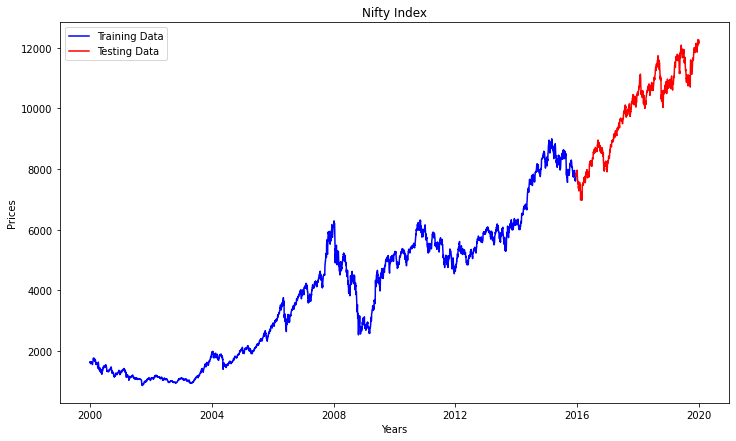

In [ ]:
#Splitting in 80:20 Ratio
train_data, test_data = nifty[0:int(len(nifty)*0.8)], nifty[int(len(nifty)*0.8):]

train_data = train_data.set_index('date', drop= False)
test_data = test_data.set_index('date', drop= False)

plt.figure(figsize=(12,7))
plt.title('Nifty Index')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.plot(train_data['price'], 'blue', label='Training Data')
plt.plot(test_data['price'], 'red', label='Testing Data')
plt.legend()

In [ ]:
print(f"Train Data Shape: {train_data.shape}")
print(f"Test Data Shape: {test_data.shape}")

Train Data Shape: (3977, 2)
Test Data Shape: (995, 2)


In [ ]:
train_data.to_csv('train.csv')
test_data.to_csv('test.csv')


#Exploratory Data Analysis

##News Data

###Checking for Missing Values

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'Count Plot on Sentiment Variable')

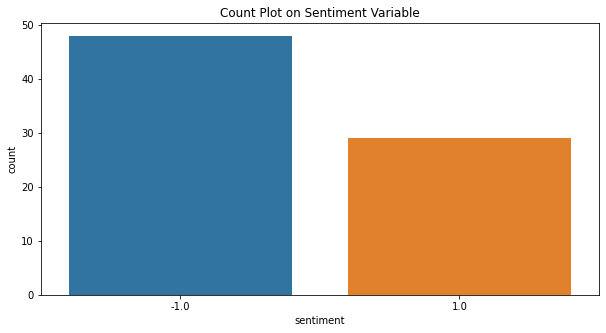

In [ ]:
plt.figure(figsize=(10, 5))
sns.countplot(tweet_news['sentiment'])
plt.title('Count Plot on Sentiment Variable')

In [ ]:
tweet_news['sentiment'].value_counts()

-1.0    48
 1.0    29
Name: sentiment, dtype: int64

As expected, we can observe more number of positive news which reflects why nifty shows an upward trend overall. We have 37% negative tweets here. Results looking realistic so far.

Word Cloud for Positive Tweets


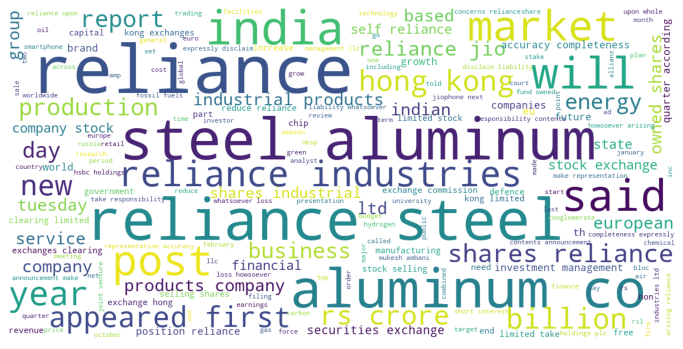


Word Cloud for Negative Tweets


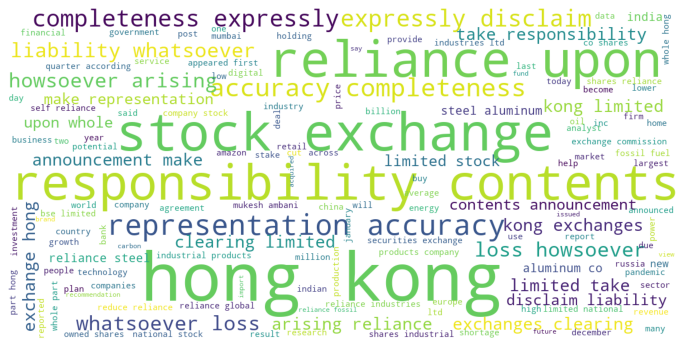

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200000,
        max_font_size=40, 
        scale=3,
        random_state=1).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

print("Word Cloud for Positive Tweets")
show_wordcloud(tweet_news[tweet_news['sentiment'] == 1].values)
print("\nWord Cloud for Negative Tweets")
show_wordcloud(tweet_news[tweet_news['sentiment'] == -1].values)

###Probability Distribution of Sentiment Scores by VADER

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Probability Distribution of Sentiment Scores by VADER')

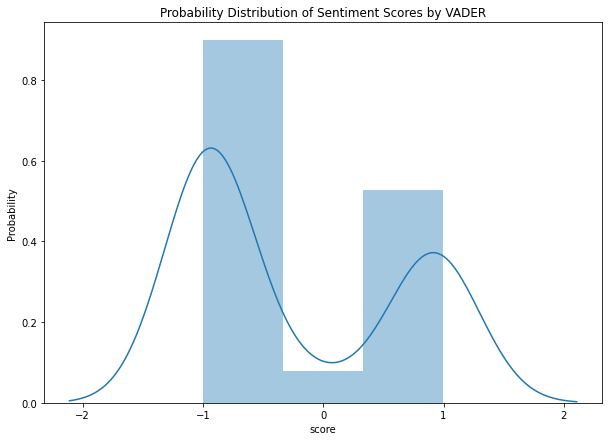

In [ ]:
plt.figure(figsize=(10, 7))
sns.distplot(tweet_news['score'])
plt.ylabel('Probability')
plt.title('Probability Distribution of Sentiment Scores by VADER')

For majority of news, VADER is confident in detecting either positive or negative sentiment since most of the points lie on the boundary. This shows accurate and confident prediction from VADER library. 

###Date-wise Distribution of News Sentiments

In [ ]:
tweet_news['date'] = tweet_news['published_at']
tweet_news = tweet_news.drop('published_at', axis=1)
tweet_news

,news_combined,score,sentiment,date
0,low profile gujarat businessman wants to add p...,-0.9815,-1.0,2021-10-21
1,rupee and bond update october reliance securit...,-0.8176,-1.0,2021-10-22
2,reliance is targeting solar manufacturing of g...,0.7264,1.0,2021-10-24
3,brussels as european governments scramble to s...,0.8225,1.0,2021-10-25
4,the reserve bank of newzealand said on wednes...,-0.9944,-1.0,2021-10-26
...,...,...,...,...
72,for the past years california voters have repe...,0.9922,1.0,2022-02-12
73,france president emmanuel macron has announced...,-0.6976,-1.0,2022-02-13
74,eps expected for reliance steel aluminum co t...,0.8225,1.0,2022-02-14
75,the board of trustees of first trust dynamic ...,-0.9959,-1.0,2022-02-15


In [ ]:
tweet_news.set_index('date', inplace = True)

In [ ]:
tweet_news

,news_combined,score,sentiment
date,,,
2021-10-21,low profile gujarat businessman wants to add p...,-0.9815,-1.0
2021-10-22,rupee and bond update october reliance securit...,-0.8176,-1.0
2021-10-24,reliance is targeting solar manufacturing of g...,0.7264,1.0
2021-10-25,brussels as european governments scramble to s...,0.8225,1.0
2021-10-26,the reserve bank of newzealand said on wednes...,-0.9944,-1.0
...,...,...,...
2022-02-12,for the past years california voters have repe...,0.9922,1.0
2022-02-13,france president emmanuel macron has announced...,-0.6976,-1.0
2022-02-14,eps expected for reliance steel aluminum co t...,0.8225,1.0


In [ ]:
tweet_news.reset_index(inplace = True)

In [ ]:
tweet_news['date'] = pd.to_datetime(tweet_news['date'])
tweet_news['date'] = tweet_news['date'].dt.date
# tweet_news.set_index('date', inplace = True)

#Modeling

##1. ARIMA

In [ ]:
from statsmodels.tsa.stattools import acf, pacf

lag_acf = acf(ts_diff, nlags=20)
lag_pacf = pacf(ts_diff, nlags=20, method='ols')

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/stattools.py:541: FutureWarning: fft=True will become the default in a future version of statsmodels. To suppress this warning, explicitly set fft=False.
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Partial Autocorrelation Function')

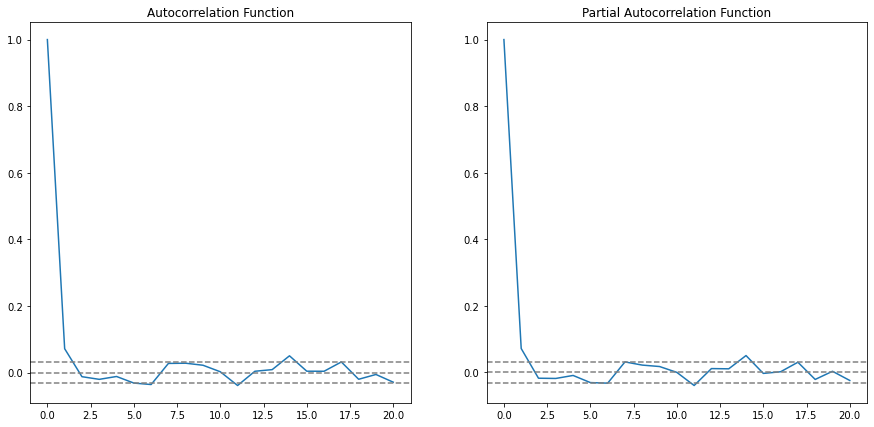

In [ ]:
plt.figure(figsize=(15,7))

#Plot ACF: 
plt.subplot(121) 
plt.plot(lag_acf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.title('Autocorrelation Function')

#Plot PACF:
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.title('Partial Autocorrelation Function')

p – The lag value where the PACF chart crosses the upper confidence interval for the first time. If you notice closely, in this case p=2.


q – The lag value where the ACF chart crosses the upper confidence interval for the first time. If you notice closely, in this case q=2.


d - In differencing method, shift of 1 period produced a stationary timer series. So we will use d = 1.

In [ ]:
from statsmodels.tsa.arima_model import ARIMA

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)


                             ARIMA Model Results                              
Dep. Variable:                D.price   No. Observations:                 3976
Model:                 ARIMA(2, 1, 2)   Log Likelihood              -21871.592
Method:                       css-mle   S.D. of innovations             59.262
Date:                Thu, 06 Aug 2020   AIC                          43755.183
Time:                        10:22:50   BIC                          43792.911
Sample:                             1   HQIC                         43768.561
                                                                              
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const             1.5496      0.986      1.571      0.116      -0.384       3.483
ar.L1.D.price    -0.5991      0.286     -2.094      0.036      -1.160      -0.038
ar.L2.D.price    -0.4093      0.227     

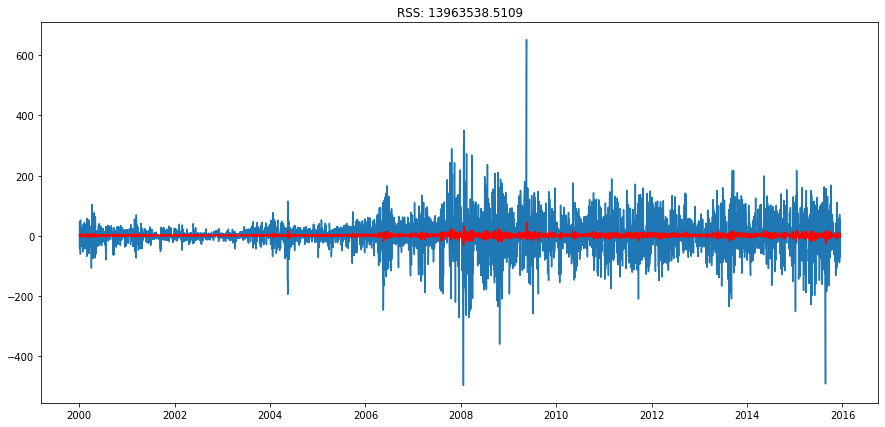

In [ ]:
plt.figure(figsize=(15,7))

model = ARIMA(ts, order=(2, 1, 2))  
results_ARIMA = model.fit(disp=-1)  
plt.plot(ts_diff)
plt.plot(results_ARIMA.fittedvalues, color='red')
plt.title('RSS: %.4f'% sum((results_ARIMA.fittedvalues-ts_diff)**2))

print(results_ARIMA.summary())

###Predicting Train Data

In [ ]:
yhat = results_ARIMA.predict(1, 3977)

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)


In [ ]:
yhat.head()

0    1.549636
1    4.625111
2   -2.393849
3    2.953179
4    2.522729
dtype: float64

In [ ]:
predictions_ARIMA_diff_cumsum = yhat.cumsum() + train_data['price'][0]
print (predictions_ARIMA_diff_cumsum.head())
print (predictions_ARIMA_diff_cumsum.tail())

0    1593.749636
1    1598.374747
2    1595.980898
3    1598.934077
4    1601.456806
dtype: float64
3972    7747.790976
3973    7743.460032
3974    7745.907615
3975    7754.003662
3976    7755.619432
dtype: float64


Let's plot the final results from ARIMA

RMSE_ARIMA = 1062.8026556847378


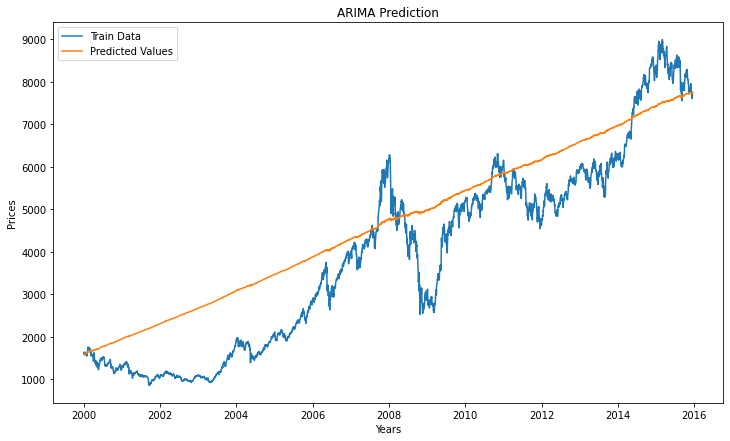

In [ ]:
#Predicting Train Data
from sklearn.metrics import mean_squared_error
from math import sqrt

predictions = pd.DataFrame(predictions_ARIMA_diff_cumsum.values)
predictions.set_index(train_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['price'], label = 'Train Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('ARIMA Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_ARIMA = sqrt(mean_squared_error(train_data['price'].values, predictions_ARIMA_diff_cumsum.values))

print(f"RMSE_ARIMA = {RMSE_ARIMA}")

###ARIMA Forecasting

In [ ]:
len(train_data), len(test_data)

(3977, 995)

In [ ]:
yhat = results_ARIMA.predict(3977, 3977+994)

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)


In [ ]:
yhat.head()

3976    1.615769
3977    0.067347
3978    2.410583
3979    1.640556
3980    1.142784
dtype: float64

In [ ]:
predictions_ARIMA_diff_cumsum = yhat.cumsum() + train_data['price'][-1]
print (predictions_ARIMA_diff_cumsum.head())
print (predictions_ARIMA_diff_cumsum.tail())

3976    7752.515769
3977    7752.583116
3978    7754.993699
3979    7756.634255
3980    7757.777039
dtype: float64
4966    9285.904064
4967    9287.453700
4968    9289.003336
4969    9290.552973
4970    9292.102609
dtype: float64


Let's plot the final results from ARIMA

RMSE_ARIMA = 1707.7770346921761


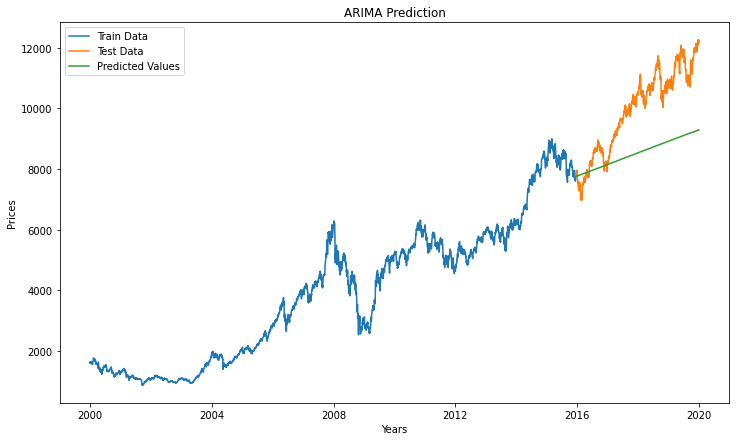

In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt

predictions = pd.DataFrame(predictions_ARIMA_diff_cumsum.values)
predictions.set_index(test_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['price'], label = 'Train Data')
plt.plot(test_data['price'], label = 'Test Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('ARIMA Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_ARIMA = sqrt(mean_squared_error(test_data['price'].values, predictions_ARIMA_diff_cumsum.values))

print(f"RMSE_ARIMA = {RMSE_ARIMA}")

We have got RMSE: 1707 from ARIMA Model. Let's see if we can improve this.

##2. SARIMAX

ARIMA Model consider only trends information in the data and ignores seasonal variation. SARIMAX is a variation of ARIMA Model which considers seasonal variation in the data as well. Though, our data do not have high seasonality but why not give it a try. 

Let's see if it improves the RMSE or not.

In [ ]:
import statsmodels.api as sm

In [ ]:
model = sm.tsa.statespace.SARIMAX(ts_diff, order=(2, 1, 2), seasonal_order=(1,1,1,12))
results_SARIMAX = model.fit()

print(results_SARIMAX.summary())

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                                 Statespace Model Results                                 
Dep. Variable:                              price   No. Observations:                 3976
Model:             SARIMAX(2, 1, 2)x(1, 1, 1, 12)   Log Likelihood              -21842.127
Date:                            Thu, 06 Aug 2020   AIC                          43698.253
Time:                                    10:35:27   BIC                          43742.246
Sample:                                         0   HQIC                         43713.855
                                           - 3976                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9264      0.041    -22.504      0.000      -1.007      -0.846
ar.L2          0.0732      0.010   

###SARIMAX Forecasting

In [ ]:
len(train_data), len(test_data)

(3977, 995)

In [ ]:
yhat = results_SARIMAX.predict(3977, 3977+994)

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)


In [ ]:
yhat.head()

3977    -0.757555
3978    10.658790
3979     0.358834
3980     5.182702
3981     3.454101
dtype: float64

In [ ]:
predictions_SARIMAX_diff_cumsum = yhat.cumsum() + train_data['price'][-1]
print (predictions_SARIMAX_diff_cumsum.head())
print (predictions_SARIMAX_diff_cumsum.tail())

3977    7750.142445
3978    7760.801235
3979    7761.160068
3980    7766.342771
3981    7769.796872
dtype: float64
4967    10720.056774
4968    10722.499933
4969    10727.479500
4970    10728.938654
4971    10725.440970
dtype: float64


Let's plot the final results from SARIMAX

In [ ]:
yhat

3977    -0.757555
3978    10.658790
3979     0.358834
3980     5.182702
3981     3.454101
          ...    
4967     0.572148
4968     2.443159
4969     4.979568
4970     1.459153
4971    -3.497684
Length: 995, dtype: float64

RMSE_SARIMAX = 964.9740144692549


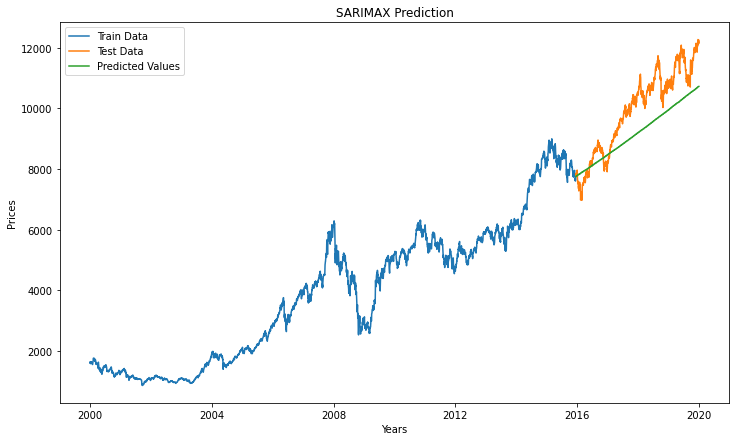

In [ ]:
predictions = pd.DataFrame(predictions_SARIMAX_diff_cumsum)
predictions.set_index(test_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['price'], label = 'Train Data')
plt.plot(test_data['price'], label = 'Test Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('SARIMAX Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_SARIMAX = sqrt(mean_squared_error(test_data['price'].values, predictions_SARIMAX_diff_cumsum))

print(f"RMSE_SARIMAX = {RMSE_SARIMAX}")

Woah! RMSE got down to 964 from 1707. SARIMAX really works well.

##3. Facebook Prophet

In [ ]:
# Rename the features: These names are NEEDED for the model fitting
ts = train_data.rename(columns = {"date":"ds","price":"y"}) 

In [ ]:
from fbprophet import Prophet
m = Prophet(daily_seasonality = True) # the Prophet class (model)
m.fit(ts) # fit the model using all data

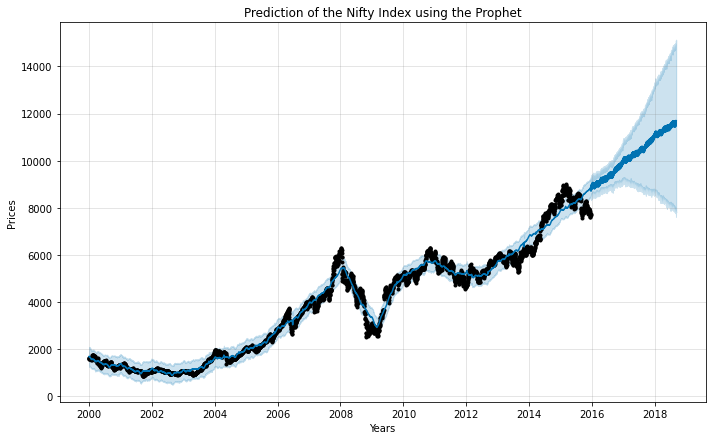

In [ ]:
future = m.make_future_dataframe(periods=994) #we need to specify the number of days in future
prediction = m.predict(future)
m.plot(prediction)

plt.title("Prediction of the Nifty Index using the Prophet")
plt.xlabel("Years")
plt.ylabel("Prices")
plt.show()

In [ ]:
yhat = prediction['yhat'].tail(995)

Elegant Plot. It shows the confidence interval as well. However, let's compare it with our test_data and find RMSE.

RMSE_Prophet = 709.7036520419836


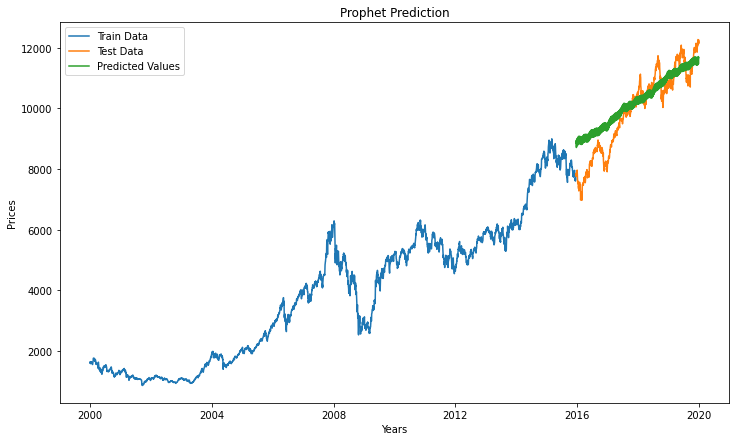

In [ ]:
predictions = pd.DataFrame(yhat)
predictions.set_index(test_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['price'], label = 'Train Data')
plt.plot(test_data['price'], label = 'Test Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('Prophet Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_Prophet = sqrt(mean_squared_error(test_data['price'].values, yhat))

print(f"RMSE_Prophet = {RMSE_Prophet}")

Nice! RMSE has futher reduced to 709 from 964. It is still far from acceptable prediction. Let's try deep learning models now.

###Plot the trend, weekly, seasonally, yearly and daily components

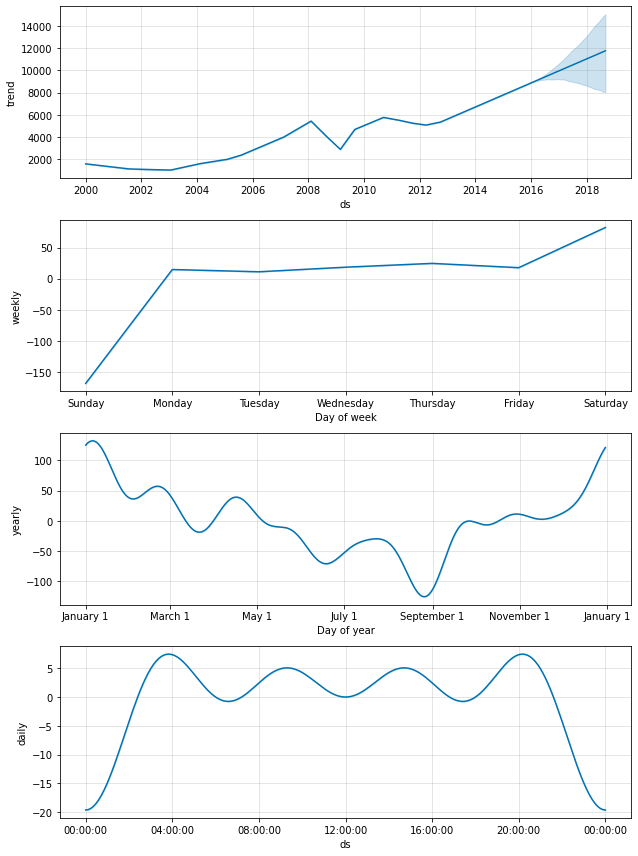

In [ ]:
m.plot_components(prediction)
plt.show()

Our data has some seasonal information present. This is why SARIMAX also performed well. 

Following points can be observed from the above graphs:
1. Our data shows an upward trend.
2. Stock price gets up on saturday and remains almost flat during weekdays.
3. There is high chance to observe 52 week low Stock Price in the August End- Sept starting period.
4. Stock Price fluctuates during the whole day.

##4. LSTM

In [ ]:
from tensorflow import keras

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping

from tensorflow.keras import backend as K

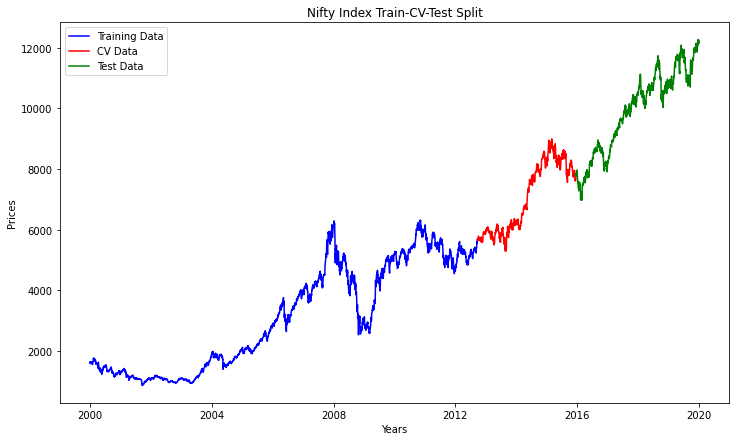

In [ ]:
#Splitting the data in Train-CV-Test in the ratio 64:16:20
X_train, X_cv = train_data[0:int(len(train_data)*0.8)], train_data[int(len(train_data)*0.8):]

X_train = X_train.set_index('date', drop= False)
X_cv = X_cv.set_index('date', drop= False)

plt.figure(figsize=(12,7))
plt.title('Nifty Index Train-CV-Test Split')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.plot(X_train['price'], 'blue', label='Training Data')
plt.plot(X_cv['price'], 'red', label='CV Data')
plt.plot(test_data['price'], 'green', label='Test Data')
plt.legend()

In [ ]:
len(X_train)

3181

In [ ]:
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)

In [ ]:
# Feature Scaling
sc = MinMaxScaler()
training_set_scaled = sc.fit_transform(X_train['price'].values.reshape(-1, 1))
cv_set_scaled = sc.transform(X_cv['price'].values.reshape(-1, 1))
test_set_scaled = sc.transform(test_data['price'].values.reshape(-1, 1))

In [ ]:
#Creating Dataset with Window Size 30.

trainX, trainY = create_dataset(training_set_scaled, 30)
cvX, cvY = create_dataset(cv_set_scaled, 30)
testX, testY = create_dataset(test_set_scaled, 30)

In [ ]:
trainX.shape, cvX.shape, testX.shape

((3150, 30), (765, 30), (964, 30))

In [ ]:
#Reshaping all the data
trainX, trainY = np.array(trainX), np.array(trainY)
trainX = np.reshape(trainX, (trainX.shape[0], trainX.shape[1], 1))

cvX, cvY = np.array(cvX), np.array(cvY)
cvX = np.reshape(cvX, (cvX.shape[0], cvX.shape[1], 1))

testX, testY = np.array(testX), np.array(testY)
testX = np.reshape(testX, (testX.shape[0], testX.shape[1], 1))

In [ ]:
#Defining our metric
def root_mean_squared_error(y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

In [ ]:
import tensorflow as tf 
from tensorflow import keras
from keras.callbacks import TensorBoard

!rm -rf ./logs/
keras.backend.clear_session()
%load_ext tensorboard

model = Sequential()

# Adding the input layer
model.add(LSTM(units=48, activation='tanh', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=26), input_shape = (X_train.shape[1], 1)))

# Adding the output layer
model.add(Dense(1, name="output_layer"))

# Compiling the RNN
model.compile(optimizer = keras.optimizers.Adam(learning_rate=0.001), loss = root_mean_squared_error)

#Using Tensorboard
logdir = "logs"
tensorboard_callback = TensorBoard(log_dir=logdir, histogram_freq=5, write_graph=True)

# Fitting the RNN to the Training set
model.fit(trainX, trainY, epochs = 50, batch_size = 16,  validation_data = (cvX, cvY), callbacks = [tensorboard_callback])

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/50
197/197 [==============================] - 3s 14ms/step - loss: 0.0366 - val_loss: 0.0624
Epoch 2/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0198 - val_loss: 0.0315
Epoch 3/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0184 - val_loss: 0.0357
Epoch 4/50
197/197 [==============================] - 2s 10ms/step - loss: 0.0168 - val_loss: 0.0228
Epoch 5/50
197/197 [==============================] - 2s 10ms/step - loss: 0.0165 - val_loss: 0.0236
Epoch 6/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0158 - val_loss: 0.0194
Epoch 7/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0151 - val_loss: 0.0182
Epoch 8/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0149 - val_loss: 0.0342
Epoch 9/50
197/197 [==============================] - 2s 11ms/step - loss: 0.0136 - val_loss: 0.0212
E

In [ ]:
%tensorboard --logdir logs/

<IPython.core.display.Javascript object>

From Tensorboard: Model is not overfitting and gradients are also not vanishing.

In [ ]:
#Predicting on test data
predicted_stock_price = model.predict(testX)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)

In [ ]:
#Changing datatype of date column from string to datetime

train_data['date'] = pd.to_datetime(train_data['date'])
test_data['date'] = pd.to_datetime(test_data['date'])

train_data['date'] = train_data['date'].dt.date
test_data['date'] = test_data['date'].dt.date

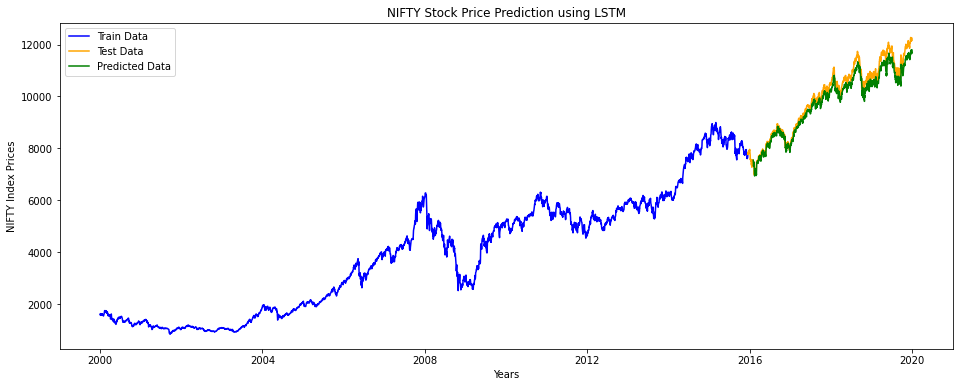

RMSE_LSTM = 285.5356095605939


In [ ]:
# Visualising the results
plt.figure(figsize=(16, 6))
plt.plot(train_data['date'], train_data['price'], color = 'blue', label = 'Train Data')
plt.plot(test_data['date'], test_data['price'].values, color = 'orange', label = 'Test Data')
plt.plot(test_data.iloc[31:]['date'], predicted_stock_price, color = 'green', label = 'Predicted Data')
plt.title('NIFTY Stock Price Prediction using LSTM')
plt.xlabel('Years')
plt.ylabel('NIFTY Index Prices')
plt.legend()
plt.show()
from math import sqrt

RMSE_LSTM = sqrt(mean_squared_error(test_data.iloc[31:]['price'].values, predicted_stock_price))

print(f"RMSE_LSTM = {RMSE_LSTM}")

Hats off to this deep learning marvel. RMSE has gone down to 285 compared to 709 from Facebook Prophet Model. LSTM Model has predicted very accurately. 
Let's try more advanced LSTM variations.

##5. LSTM with news polarity

In [ ]:
common_dates = [x for x in s if x in n]

In [ ]:
#Removing news for missing dates in stock price data. In Stock Price Data, data corresponding to weekend, public holidays are missing.

# s = set([str(i).split('T')[0] for i in nifty_5yrs['date'].values])
# s = set(list(nifty_5yrs.index))
# n = set(list(tweet_news.index.values))
s = set(list(nifty_5yrs['date']))
n = set(list(tweet_news['date']))

common_dates_1 = list(n.symmetric_difference(s))

for i in tweet_news.itertuples():
    if i[1] not in [str(i).split('T')[0] for i in nifty_5yrs['Date'].values]:
        tweet_news.drop(tweet_news[tweet_news['date'] == i[1]].index, inplace = True)
    else:
        pass

for j in common_dates_1:
    tweet_news.drop(tweet_news[tweet_news['date'] == j].index, inplace = True)
    nifty_5yrs.drop(nifty_5yrs[nifty_5yrs['Date'] == j].index, inplace = True)

## Apple/ Microsoft

In [ ]:
# data = apple
# data = microsoft
# data = nifty
data = dow

In [ ]:
data

,close_price,date,score,open_price,open-close
0,29.12,2006-12-01,0.0000,29.230000,0.110000
1,29.33,2006-12-04,-0.7783,29.230000,-0.100000
2,29.13,2006-12-05,0.0000,29.360001,0.230001
3,28.99,2006-12-06,0.9003,29.100000,0.110000
4,28.85,2006-12-07,0.6597,28.959999,0.109999
...,...,...,...,...,...
2512,60.40,2016-11-23,0.8478,61.009998,0.609998
2513,60.53,2016-11-25,0.0000,60.299999,-0.230001
2514,60.61,2016-11-28,0.0000,60.340000,-0.270000
2515,61.09,2016-11-29,0.0000,60.650002,-0.439998


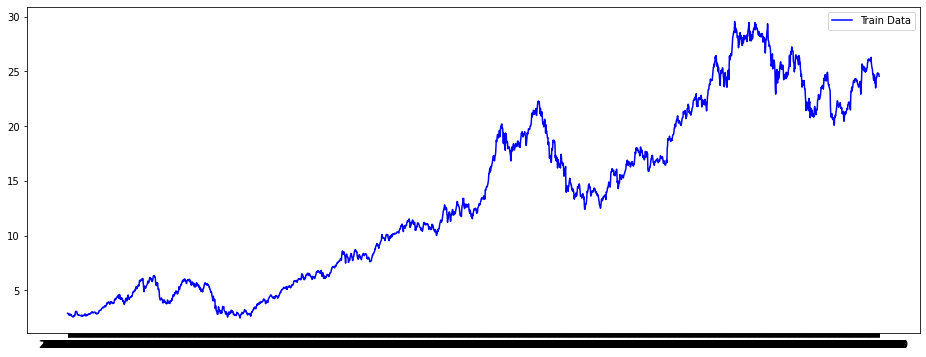

In [ ]:
plt.figure(figsize=(16, 6))
plt.plot(data['date'], data['close_price'], color = 'blue', label = 'Train Data')
# plt.plot(test_data['date'], test_data['close_price'].values, color = 'orange', label = 'Test Data')
# plt.plot(test_data.iloc[61:]['date'], predicted_stock_price, color = 'green', label = 'Predicted Data')
plt.legend()
plt.show()

In [ ]:
train_data, test_data = data[0:int(len(data)*0.8)], data[int(len(data)*0.8):]

train_data = train_data.set_index('date', drop= False)
test_data = test_data.set_index('date', drop= False)

In [ ]:
train_data

,date,score,close_price
date,,,
08-08-2008,08-08-2008,-0.382692,11734.32
11-08-2008,11-08-2008,-0.174032,11782.35
12-08-2008,12-08-2008,-0.215776,11642.47
13-08-2008,13-08-2008,-0.155804,11532.96
14-08-2008,14-08-2008,-0.154708,11615.93
...,...,...,...
24-11-2014,24-11-2014,-0.150196,17817.90
25-11-2014,25-11-2014,-0.227720,17814.94
26-11-2014,26-11-2014,-0.201372,17827.75


In [ ]:
test_data

,date,score,close_price
date,,,
02-12-2014,02-12-2014,0.000748,17879.55
03-12-2014,03-12-2014,-0.274576,17912.62
04-12-2014,04-12-2014,-0.375052,17900.10
05-12-2014,05-12-2014,-0.191768,17958.79
08-12-2014,08-12-2014,-0.226136,17852.48
...,...,...,...
24-06-2016,24-06-2016,-0.060040,17400.75
27-06-2016,27-06-2016,-0.092844,17140.24
28-06-2016,28-06-2016,-0.050452,17409.72


In [ ]:
X_train, X_cv = train_data[0:int(len(train_data)*0.8)], train_data[int(len(train_data)*0.8):]

X_train = X_train.set_index('date', drop= False)
X_cv = X_cv.set_index('date', drop= False)

In [ ]:
X_train

,date,score,close_price
date,,,
08-08-2008,08-08-2008,-0.382692,11734.32
11-08-2008,11-08-2008,-0.174032,11782.35
12-08-2008,12-08-2008,-0.215776,11642.47
13-08-2008,13-08-2008,-0.155804,11532.96
14-08-2008,14-08-2008,-0.154708,11615.93
...,...,...,...
21-08-2013,21-08-2013,-0.370076,14897.55
22-08-2013,22-08-2013,-0.333784,14963.74
23-08-2013,23-08-2013,-0.331124,15010.51


In [ ]:
X_cv

,date,score,close_price
date,,,
28-08-2013,28-08-2013,-0.062980,14824.51
29-08-2013,29-08-2013,-0.276376,14840.95
30-08-2013,30-08-2013,-0.195200,14810.31
03-09-2013,03-09-2013,-0.108324,14833.96
04-09-2013,04-09-2013,-0.172312,14930.87
...,...,...,...
24-11-2014,24-11-2014,-0.150196,17817.90
25-11-2014,25-11-2014,-0.227720,17814.94
26-11-2014,26-11-2014,-0.201372,17827.75


In [ ]:
def create_dataset(dataset, scoreset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		b = scoreset[i+look_back-1]
		dataX.append(np.append(a,b))
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)

try changing b to [i+look_back-2]

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
# Feature Scaling
sc = MinMaxScaler()
training_set_scaled = sc.fit_transform(X_train['close_price'].values.reshape(-1, 1))
cv_set_scaled = sc.transform(X_cv['close_price'].values.reshape(-1, 1))
test_set_scaled = sc.transform(test_data['close_price'].values.reshape(-1, 1))

sc1 = MinMaxScaler()
training_score_scaled = sc1.fit_transform(X_train['score'].values.reshape(-1, 1))
cv_score_scaled = sc1.transform(X_cv['score'].values.reshape(-1, 1))
test_score_scaled = sc1.transform(test_data['score'].values.reshape(-1, 1))

In [ ]:
import joblib
joblib.dump(sc, 'dow_scaler.save') 

# And now to load...

# scaler = joblib.load('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/apple_scaler.save') 

['dow_scaler.save']

In [ ]:
trainX, trainY = create_dataset(training_set_scaled, training_score_scaled, 60)
cvX, cvY = create_dataset(cv_set_scaled, cv_score_scaled, 60)
testX, testY = create_dataset(test_set_scaled, test_score_scaled, 60)

In [ ]:
#Reshaping all data.

trainX, trainY = np.array(trainX), np.array(trainY)
trainX = np.reshape(trainX, (trainX.shape[0], trainX.shape[1], 1))

cvX, cvY = np.array(cvX), np.array(cvY)
cvX = np.reshape(cvX, (cvX.shape[0], cvX.shape[1], 1))

testX, testY = np.array(testX), np.array(testY)
testX = np.reshape(testX, (testX.shape[0], testX.shape[1], 1))

In [ ]:
testX.shape

(443, 61)

learning_rate=0.001 [microsoft],
              0.01  [apple]

In [ ]:
import tensorflow as tf 
from tensorflow import keras
from keras.callbacks import TensorBoard
from keras import Sequential
from keras.layers import LSTM, Dense
!rm -rf ./logs/
keras.backend.clear_session()
%load_ext tensorboard

model = Sequential()

# Adding the input layer
model.add(LSTM(units=128, activation='tanh', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=26), input_shape = (trainX.shape[1], 1), unroll = True))

# Adding the output layer
model.add(Dense(1, name="output_layer"))

# Compiling the RNN
model.compile(optimizer = keras.optimizers.Adam(learning_rate=0.001), loss = 'mean_absolute_error')

#Using Tensorboard
logdir = "logs"
tensorboard_callback = TensorBoard(log_dir=logdir, histogram_freq=5, write_graph=True)

# Fitting the RNN to the Training set
model.fit(trainX, trainY, epochs = 50, batch_size = 64,  validation_data = (cvX, cvY), callbacks = [tensorboard_callback])

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/50
19/19 [==============================] - 18s 191ms/step - loss: 0.1286 - val_loss: 0.1254
Epoch 2/50
19/19 [==============================] - 2s 97ms/step - loss: 0.0275 - val_loss: 0.0339
Epoch 3/50
19/19 [==============================] - 2s 97ms/step - loss: 0.0212 - val_loss: 0.0350
Epoch 4/50
19/19 [==============================] - 2s 95ms/step - loss: 0.0211 - val_loss: 0.0194
Epoch 5/50
19/19 [==============================] - 2s 94ms/step - loss: 0.0211 - val_loss: 0.0313
Epoch 6/50
19/19 [==============================] - 2s 98ms/step - loss: 0.0212 - val_loss: 0.0228
Epoch 7/50
19/19 [==============================] - 2s 95ms/step - loss: 0.0200 - val_loss: 0.0211
Epoch 8/50
19/19 [==============================] - 2s 96ms/step - loss: 0.0196 - val_loss: 0.0190
Epoch 9/50
19/19 [==============================] - 2s 95ms/step - loss: 0.0185 - val_loss: 0.0202
Epoch 10/50
19/19

In [ ]:
%tensorboard --logdir logs/

Reusing TensorBoard on port 6006 (pid 1833), started 3:00:12 ago. (Use '!kill 1833' to kill it.)

<IPython.core.display.Javascript object>

From Tensorboard: Model is not overfitting and gradients are also not vanishing.

In [ ]:
#Predicting on test data
predicted_stock_price = model.predict(testX)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)

### save model

In [ ]:
# model.save('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/apple_savedmodel')
model.save('/content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/dow_savedmodel')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/dow_savedmodel/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/Atharvan_Workspace/Nifty-Index-Prediction-Using-News-Sentiments/dow_savedmodel/assets


In [ ]:
#Changing datatype of date column from string to datetime

train_data['date'] = pd.to_datetime(train_data['date'])
test_data['date'] = pd.to_datetime(test_data['date'])

train_data['date'] = train_data['date'].dt.date
test_data['date'] = test_data['date'].dt.date

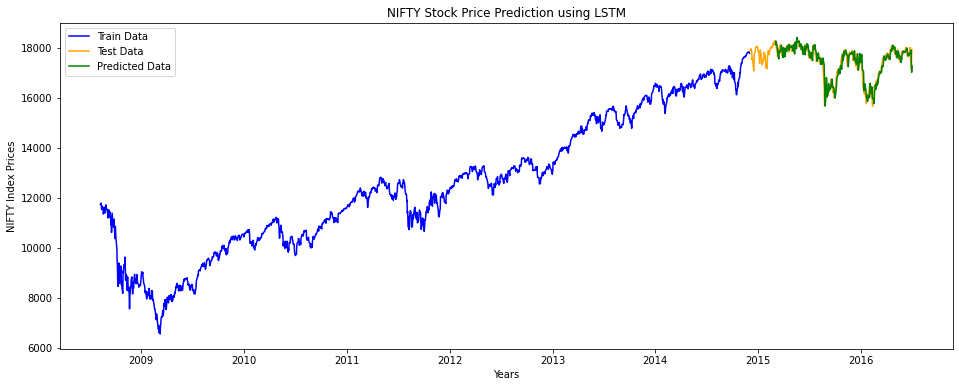

RMSE_LSTM = 242.26276536163746


In [ ]:
# Visualising the results
plt.figure(figsize=(16, 6))
plt.plot(train_data['date'], train_data['close_price'], color = 'blue', label = 'Train Data')
plt.plot(test_data['date'], test_data['close_price'].values, color = 'orange', label = 'Test Data')
plt.plot(test_data.iloc[61:]['date'], predicted_stock_price, color = 'green', label = 'Predicted Data')
plt.title('NIFTY Stock Price Prediction using LSTM')
plt.xlabel('Years')
plt.ylabel('NIFTY Index Prices')
plt.legend()
plt.show()
from math import sqrt
from sklearn.metrics import mean_squared_error

RMSE_LSTM = sqrt(mean_squared_error(test_data.iloc[61:]['close_price'].values, predicted_stock_price))

print(f"RMSE_LSTM = {RMSE_LSTM}")

In [ ]:
train_data['date']

date
08-08-2008    2008-08-08
11-08-2008    2008-11-08
12-08-2008    2008-12-08
13-08-2008    2008-08-13
14-08-2008    2008-08-14
                 ...    
24-11-2014    2014-11-24
25-11-2014    2014-11-25
26-11-2014    2014-11-26
28-11-2014    2014-11-28
01-12-2014    2014-01-12
Name: date, Length: 1590, dtype: object

In [ ]:
train_data['close_price']

date
08-08-2008    11734.32
11-08-2008    11782.35
12-08-2008    11642.47
13-08-2008    11532.96
14-08-2008    11615.93
                ...   
24-11-2014    17817.90
25-11-2014    17814.94
26-11-2014    17827.75
28-11-2014    17828.24
01-12-2014    17776.80
Name: close_price, Length: 1590, dtype: float64

##Summary

In [ ]:
from prettytable import PrettyTable
    
x = PrettyTable()

x.field_names = ["Model", "RMSE on Test Data"]

x.add_row(["ARIMA", 1707.77])
x.add_row(["SARIMAX", 964.97])
x.add_row(["FB Prophet", 709.71])
x.add_row(["LSTM", 285.53])
x.add_row(["LSTM with News Sentiments", 170.91])

print(x)

+---------------------------+-------------------+
|           Model           | RMSE on Test Data |
+---------------------------+-------------------+
|           ARIMA           |      1707.77      |
|          SARIMAX          |       964.97      |
|         FB Prophet        |       709.71      |
|            LSTM           |       285.53      |
| LSTM with News Sentiments |       170.91      |
+---------------------------+-------------------+


##Best Model: LSTM with News Sentiments
##RMSE: 170.91